In [1]:
import os
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn import preprocessing
from sklearn import metrics

import scipy.stats as stats
import scipy.signal
from scipy.stats import spearmanr, pearsonr

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
%matplotlib inline
sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})

import random
import math
import collections
from collections import Counter
from collections import OrderedDict
from itertools import product
from copy import deepcopy
from tqdm import tqdm, trange

import anndata as ad
import scanpy as sc
import tempfile
import subprocess
import shlex
import logging
import logomaker
import pickle

import torch
import torch.nn as nn
import torch.nn.functional as F

seed = 1337
random.seed(seed)
np.random.seed(seed)

In [2]:
def r2(x,y):
    slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
    return r_value**2

def performances(label, pred):
    
    r = r2(label, pred)
    pearson_r = pearsonr(label, pred)[0]
    sp_cor = spearmanr(label, pred)[0]
    print(f'r-squared = {r:.4f} | pearson r = {pearson_r:.4f} | spearman R = {sp_cor:.4f}')
            
    return [r, pearson_r, sp_cor]

In [3]:
def load_data(species_idx, species_file, interval = 50):
    
    species = species_file.split('_')[2]
    species_data = np.load(pwd + species_file, allow_pickle=True)
#     print(list(species_data.keys()))

    species_repr = species_data[obj_col]
    species_seq = species_data['sequences']
    species_energy = [eval(l.split('|')[0]) for l in species_data['labels']]

    print(f'{species} Index = {i}: n = {len(species_seq)} | embedding = {species_repr.shape}')
    
    df = pd.DataFrame([species_seq, species_energy],
                      index = ['seqeuences', 'energy']).T
    
    
    df['energy_class'] = [f'{(math.ceil(i / interval)-1)*interval} ~ {math.ceil(i / interval)*interval}' for i in df.energy]
    df['species_class'] = i
    df['species'] = species
    
    return species_repr, df, list(species_seq)


In [4]:
from itertools import product
def kmers_list(ngrams = 3):
    kmers = list('AGCT')
    for i in trange(1, ngrams):
        kmers = [''.join(c) for c in list(product(kmers, 'AGCT'))]
        print(f'{i+1}-mers: {len(kmers)}')
    return kmers

def kmer_feature(seqs, mers, k = 4):

    kmer_map = []
    for seq in seqs:
        norm = len(seq)-k+1
        kmer_map.append([seq.count(m)/norm for m in mers])
    kmer_map = np.array(kmer_map)
    print('kmer shape = ', kmer_map.shape)
    return kmer_map

mers = kmers_list(4)

100%|██████████| 3/3 [00:00<00:00, 13981.01it/s]

2-mers: 16
3-mers: 64
4-mers: 256


In [5]:
global obj_col, pwd
obj_col = 'representations_bos_lastLayer_ESM2'
pwd = './'
npz_files = [f for f in os.listdir(pwd) if '.npz' in f]
npz_files

['Pretrained_Fivespecies_chicken__ESM2SISS_FS4.1_fiveSpeciesCao_6layers_16heads_128embedsize_4096batchToks_lr1e-05_supervisedweight1.0_structureweight1.0_MLMLossMin_epoch93__representations_bos.npz',
 'Pretrained_Fivespecies_mouse__ESM2SISS_FS4.1_fiveSpeciesCao_6layers_16heads_128embedsize_4096batchToks_lr1e-05_supervisedweight1.0_structureweight1.0_MLMLossMin_epoch93__representations_bos.npz',
 'Pretrained_Fivespecies_human__ESM2SISS_FS4.1_fiveSpeciesCao_6layers_16heads_128embedsize_4096batchToks_lr1e-05_supervisedweight1.0_structureweight1.0_MLMLossMin_epoch93__representations_bos.npz',
 'Pretrained_Fivespecies_rat__ESM2SISS_FS4.1_fiveSpeciesCao_6layers_16heads_128embedsize_4096batchToks_lr1e-05_supervisedweight1.0_structureweight1.0_MLMLossMin_epoch93__representations_bos.npz',
 'Pretrained_Fivespecies_zebrafish__ESM2SISS_FS4.1_fiveSpeciesCao_6layers_16heads_128embedsize_4096batchToks_lr1e-05_supervisedweight1.0_structureweight1.0_MLMLossMin_epoch93__representations_bos.npz']

# data generate

In [6]:
embedding_adata_esm2_ori_dict, embedding_adata_esm2_umap_dict = dict(), dict()
embedding_adata_kmer_ori_dict, embedding_adata_kmer_umap_dict = dict(), dict()
for i, f in tqdm(enumerate(npz_files)):
    temp_repr, temp_df, temp_seq = load_data(i, f, 50)
    temp_kmer = kmer_feature(temp_seq, mers, 4)
    species = f.split('_')[2]
    
    if i == 0:
        fivespecies_repr = temp_repr
        fivespecies_kmer = temp_kmer
        fivespecies_df = temp_df
        fivespecies_seqs = temp_seq
    else:
        fivespecies_repr = np.vstack([fivespecies_repr, temp_repr])
        fivespecies_kmer = np.vstack([fivespecies_kmer, temp_kmer])
        fivespecies_df = pd.concat([fivespecies_df, temp_df], axis = 0)
        fivespecies_seqs += temp_seq
    #######
    embedding_adata_esm2 = ad.AnnData(temp_repr, obs = temp_df)
    embedding_adata_esm2_ori_dict[species] = embedding_adata_esm2
    
    sc.pp.pca(embedding_adata_esm2, n_comps=50)
    sc.pp.neighbors(embedding_adata_esm2)
    sc.tl.umap(embedding_adata_esm2)
    print(embedding_adata_esm2)
    embedding_adata_esm2_umap_dict[species] = embedding_adata_esm2
    
    embedding_adata_kmer = ad.AnnData(temp_kmer, obs = temp_df)
    embedding_adata_kmer_ori_dict[species] = embedding_adata_kmer
    
    sc.pp.pca(embedding_adata_kmer, n_comps=50)
    sc.pp.neighbors(embedding_adata_kmer)
    sc.tl.umap(embedding_adata_kmer)
    print(embedding_adata_kmer)
    embedding_adata_kmer_umap_dict[species] = embedding_adata_kmer
    
    print(fivespecies_repr.shape, fivespecies_kmer.shape, fivespecies_df.shape, len(fivespecies_seqs))

0it [00:00, ?it/s]

chicken Index = 0: n = 31577 | embedding = (31577, 128)
kmer shape =  (31577, 256)


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
2023-06-04 14:22:58.478272: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-04 14:22:59.372447: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


AnnData object with n_obs × n_vars = 31577 × 128
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


/tmp/ipykernel_1358479/2451576134.py:28: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  embedding_adata_kmer = ad.AnnData(temp_kmer, obs = temp_df)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
1it [01:35, 95.45s/it]

AnnData object with n_obs × n_vars = 31577 × 256
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
(31577, 128) (31577, 256) (31577, 5) 31577
mouse Index = 1: n = 48378 | embedding = (48378, 128)
kmer shape =  (48378, 256)


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 48378 × 128
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


/tmp/ipykernel_1358479/2451576134.py:28: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  embedding_adata_kmer = ad.AnnData(temp_kmer, obs = temp_df)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
2it [03:22, 102.37s/it]

AnnData object with n_obs × n_vars = 48378 × 256
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
(79955, 128) (79955, 256) (79955, 5) 79955
human Index = 2: n = 77835 | embedding = (77835, 128)
kmer shape =  (77835, 256)


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 77835 × 128
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


/tmp/ipykernel_1358479/2451576134.py:28: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  embedding_adata_kmer = ad.AnnData(temp_kmer, obs = temp_df)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
3it [06:23, 138.00s/it]

AnnData object with n_obs × n_vars = 77835 × 256
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
(157790, 128) (157790, 256) (157790, 5) 157790
rat Index = 3: n = 27740 | embedding = (27740, 128)
kmer shape =  (27740, 256)


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 27740 × 128
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


/tmp/ipykernel_1358479/2451576134.py:28: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  embedding_adata_kmer = ad.AnnData(temp_kmer, obs = temp_df)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
4it [07:23, 107.35s/it]

AnnData object with n_obs × n_vars = 27740 × 256
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
(185530, 128) (185530, 256) (185530, 5) 185530
zebrafish Index = 4: n = 28819 | embedding = (28819, 128)
kmer shape =  (28819, 256)


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 28819 × 128
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


/tmp/ipykernel_1358479/2451576134.py:28: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  embedding_adata_kmer = ad.AnnData(temp_kmer, obs = temp_df)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
5it [08:24, 100.88s/it]

AnnData object with n_obs × n_vars = 28819 × 256
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
(214349, 128) (214349, 256) (214349, 5) 214349


In [7]:
all_embedding_adata_esm2 = ad.AnnData(fivespecies_repr, obs = fivespecies_df)
embedding_adata_esm2_ori_dict['all'] = all_embedding_adata_esm2
sc.pp.pca(all_embedding_adata_esm2, n_comps=50)
sc.pp.neighbors(all_embedding_adata_esm2)
sc.tl.umap(all_embedding_adata_esm2)
embedding_adata_esm2_umap_dict['all'] = all_embedding_adata_esm2
print(all_embedding_adata_esm2)

all_embedding_adata_kmer = ad.AnnData(fivespecies_kmer, obs = fivespecies_df)
embedding_adata_kmer_ori_dict['all'] = all_embedding_adata_kmer
sc.pp.pca(all_embedding_adata_kmer, n_comps=50)
sc.pp.neighbors(all_embedding_adata_kmer)
sc.tl.umap(all_embedding_adata_kmer)
embedding_adata_kmer_umap_dict['all'] = all_embedding_adata_kmer
print(all_embedding_adata_kmer)

/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 214349 × 128
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


/tmp/ipykernel_1358479/288182773.py:9: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  all_embedding_adata_kmer = ad.AnnData(fivespecies_kmer, obs = fivespecies_df)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 214349 × 256
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


In [8]:
for i in range(5):
    for j in trange(i+1, 5):
        f1, f2 = npz_files[i], npz_files[j]
        if f1 != f2:
            species_1 = f1.split('_')[2]
            species_2 = f2.split('_')[2]
            print(f'{species_1}-{species_2}')
            # esm2
            pair_embedding_adata_esm2 = ad.concat([embedding_adata_esm2_ori_dict[species_1], 
                                                   embedding_adata_esm2_ori_dict[species_2]], merge="same")
            embedding_adata_esm2_ori_dict[f'{species_1}-{species_2}'] = pair_embedding_adata_esm2
            
            sc.pp.pca(pair_embedding_adata_esm2, n_comps=50)
            sc.pp.neighbors(pair_embedding_adata_esm2)
            sc.tl.umap(pair_embedding_adata_esm2)

            embedding_adata_esm2_umap_dict[f'{species_1}-{species_2}'] = pair_embedding_adata_esm2
            
            # kmer
            pair_embedding_adata_kmer = ad.concat([embedding_adata_kmer_ori_dict[species_1], 
                                                   embedding_adata_kmer_ori_dict[species_2]], merge="same")
            embedding_adata_kmer_ori_dict[f'{species_1}-{species_2}'] = pair_embedding_adata_kmer
            
            sc.pp.pca(pair_embedding_adata_kmer, n_comps=50)
            sc.pp.neighbors(pair_embedding_adata_kmer)
            sc.tl.umap(pair_embedding_adata_kmer)

            embedding_adata_kmer_umap_dict[f'{species_1}-{species_2}'] = pair_embedding_adata_kmer
             

  0%|          | 0/4 [00:00<?, ?it/s]

chicken-mouse


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
 25%|██▌       | 1/4 [02:39<07:57, 159.17s/it]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


chicken-human


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
 50%|█████     | 2/4 [06:37<06:50, 205.44s/it]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


chicken-rat


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
 75%|███████▌  | 3/4 [08:34<02:45, 165.44s/it]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


chicken-zebrafish


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
  0%|          | 0/3 [00:00<?, ?it/s]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


mouse-human


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
 33%|███▎      | 1/3 [04:22<08:44, 262.19s/it]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


mouse-rat


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
 67%|██████▋   | 2/3 [06:51<03:15, 195.78s/it]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


mouse-zebrafish


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
  0%|          | 0/2 [00:00<?, ?it/s]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


human-rat


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
 50%|█████     | 1/2 [03:46<03:46, 226.92s/it]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


human-zebrafish


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
  0%|          | 0/1 [00:00<?, ?it/s]/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


rat-zebrafish


/home/ubuntu/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
100%|██████████| 1/1 [01:49<00:00, 109.64s/it]
0it [00:00, ?it/s]


In [9]:
embedding_adata_esm2

AnnData object with n_obs × n_vars = 28819 × 128
    obs: 'seqeuences', 'energy', 'energy_class', 'species_class', 'species'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

# energy plot

In [10]:
def ceil_floor(minimum = -188, maximum = 0, step = 50):
    result = [x for x in range(int(minimum//step*step), int((maximum+step-1)//step*step+1), step)]
    result[0] = math.floor(minimum)
    return result

In [11]:
def plot_anndata_rep_energy(
    a,
    color,
    representation = "umap",
    representation_axes_label = "",
    swap_axes = False,
    cmap = "viridis",
    legend_size = None,
    figsize = (6.4, 4.8),
    fname = "",
    title = "",
    **kwargs,
):
    """
    Plot the given adata's representation, directly labelling instead of using
    a legend
    """
    rep_key = "X_" + representation

    assert (
        rep_key in a.obsm
    ), f"Representation {representation} not fount in keys {a.obsm.keys()}"

    coords = a.obsm[rep_key]
    if swap_axes:
        coords = coords[:, ::-1]  # Reverse the columns
    assert isinstance(coords, np.ndarray) and len(coords.shape) == 2
    assert coords.shape[0] == a.n_obs

    fig, (ax,ax1) = plt.subplots(nrows = 1, ncols = 2, figsize=figsize)
    scatter = ax.scatter(
        coords[:, 0], coords[:, 1], s=1, c=color, 
        cmap=plt.cm.get_cmap(cmap), alpha=1.0
    )
    colorbar = fig.colorbar(scatter, ax=ax)
    colorbar.set_ticks(ceil_floor(minimum = min(color), maximum = max(color), step = 50))
    rep_str = representation_axes_label if representation_axes_label else representation
    if not swap_axes:
        ax.set(
            xlabel=f"{rep_str.upper()}1", ylabel=f"{rep_str.upper()}2",
        )
    else:
        ax.set(
            xlabel=f"{rep_str.upper()}2", ylabel=f"{rep_str.upper()}1",
        )
    ax.set(**kwargs)
    ax.set(xticks=[], yticks=[])
    ###
    sns.kdeplot(temp_embedding_adata.obs['energy'].reset_index(drop = True), ax = ax1)
    ax1.text(x=-400,
             y=0.001,
             s='\n'.join([f'{key}: n={value}' for key, value in Counter(a.obs['energy_class']).items()]))
    ###
    plt.suptitle(title)
#     if fname:
#         fig.savefig(fname, bbox_inches="tight", format = 'svg')
    return fig


/tmp/ipykernel_1358479/4237990305.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  plt.cm.get_cmap('gnuplot2')


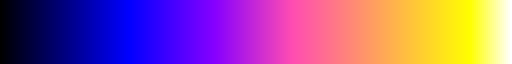

In [12]:
plt.cm.get_cmap('gnuplot2')

/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap(cmap), alpha=1.0
/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap(cmap), alpha=1.0
/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap(cmap), alpha=1.0
/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecate

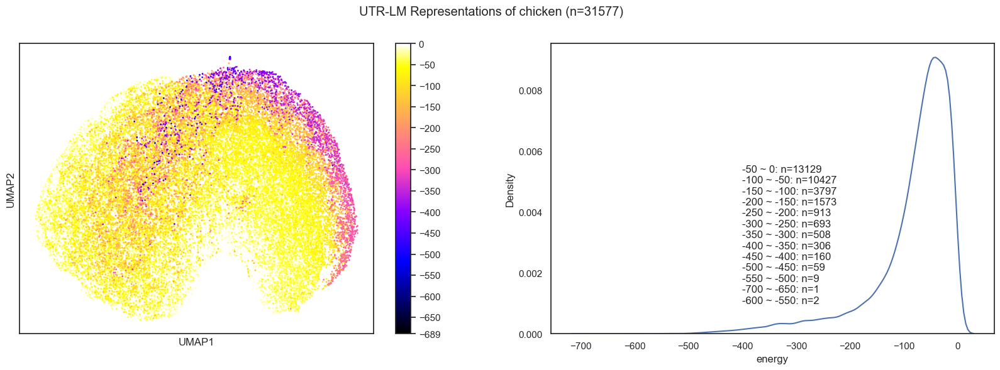

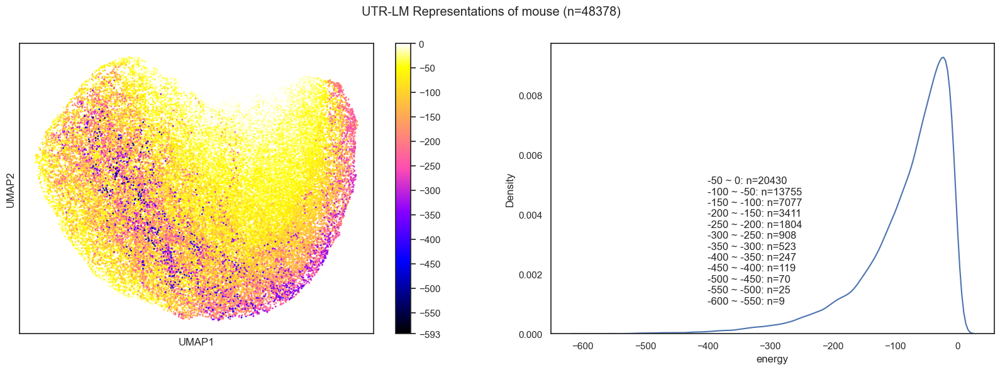

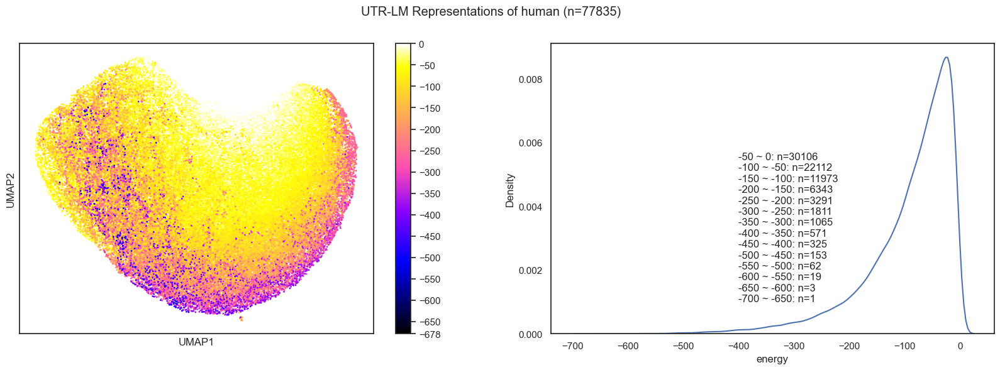

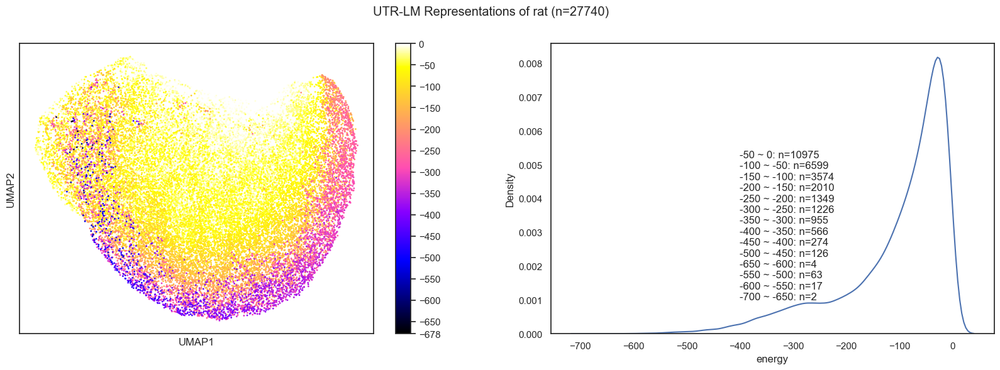

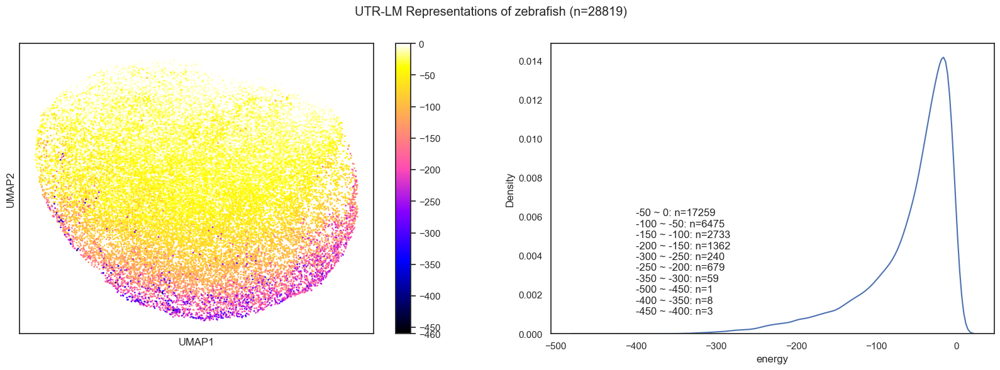

...

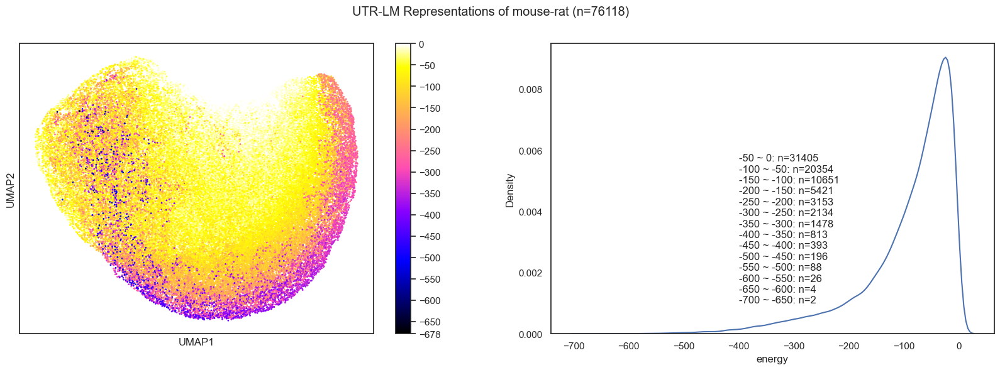

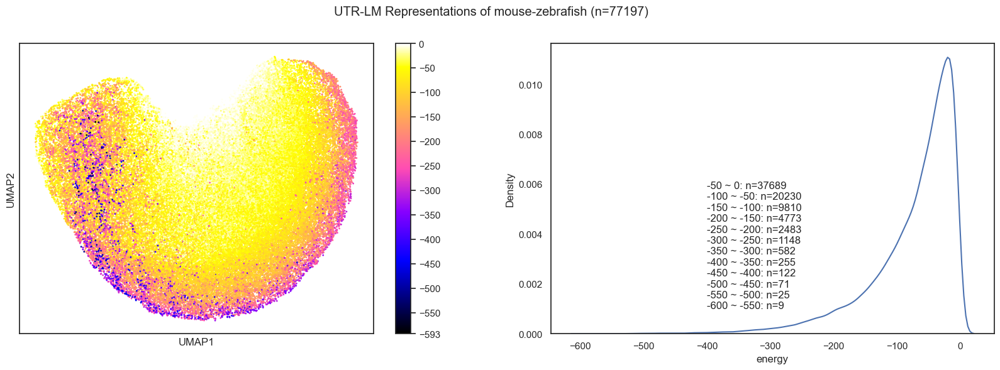

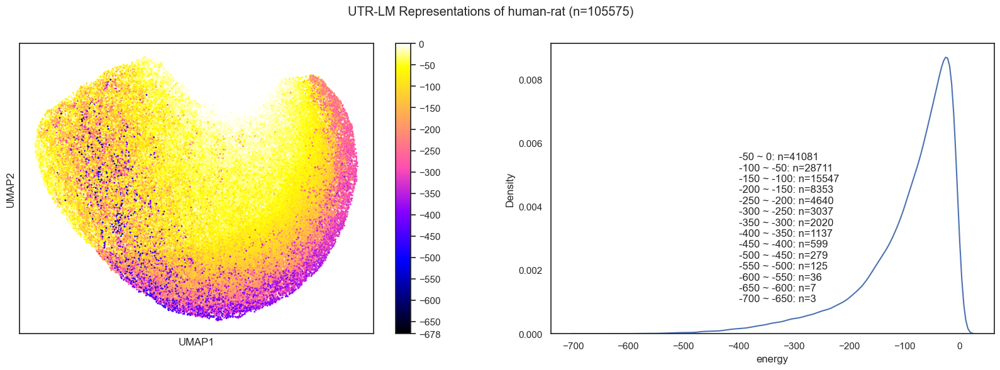

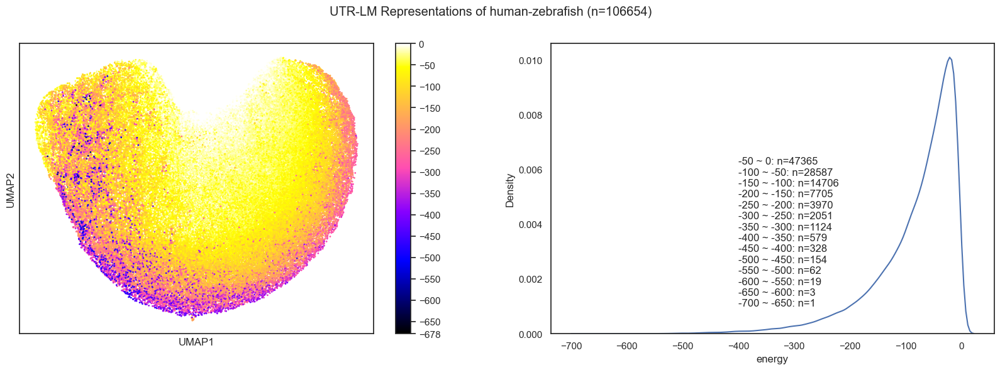

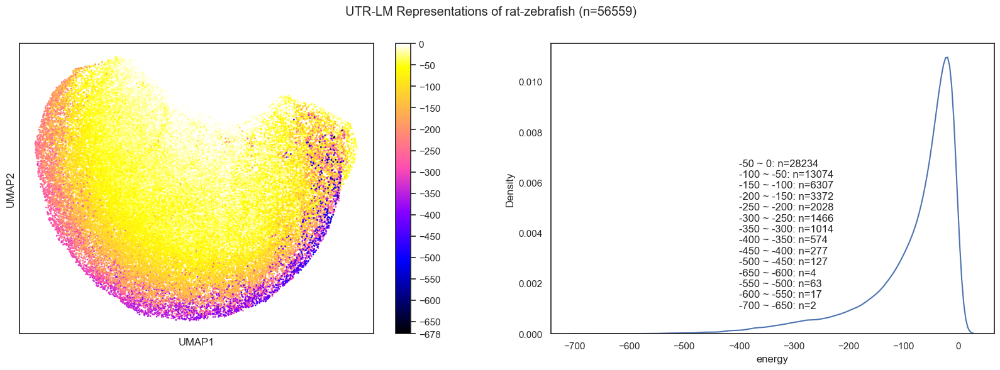

In [13]:
for species in embedding_adata_esm2_umap_dict.keys():
    temp_embedding_adata = embedding_adata_esm2_umap_dict[species]

    plot_anndata_rep_energy(
    temp_embedding_adata, color=temp_embedding_adata.obs['energy'], cmap = 'gnuplot2',
    title=f"UTR-LM Representations of {species} (n={len(temp_embedding_adata.obs['species'])})",
    legend_size=7, figsize = (20, 6), fname = f'UTRLM_{species}_Energy.svg', 
    ).show()
#     break

/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap(cmap), alpha=1.0
/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap(cmap), alpha=1.0
/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap(cmap), alpha=1.0
/tmp/ipykernel_1358479/3175443408.py:33: MatplotlibDeprecationWarning: The get_cmap function was deprecate

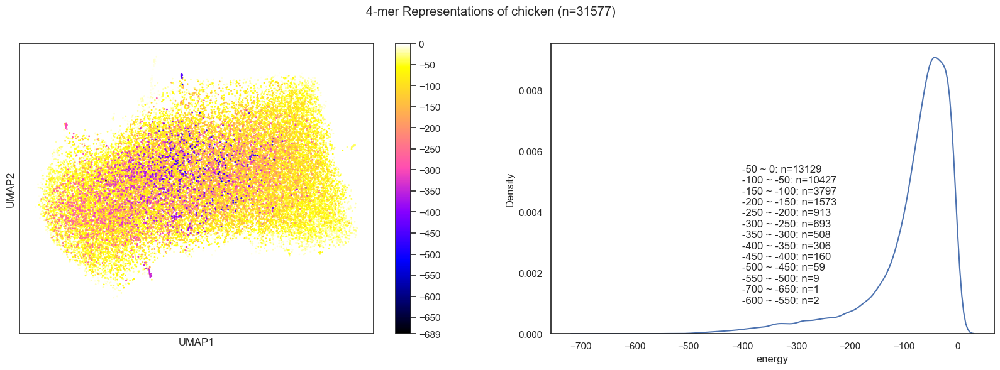

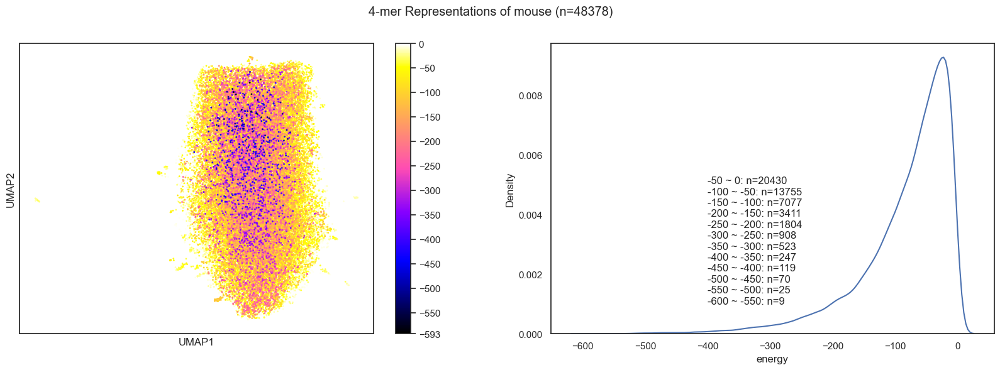

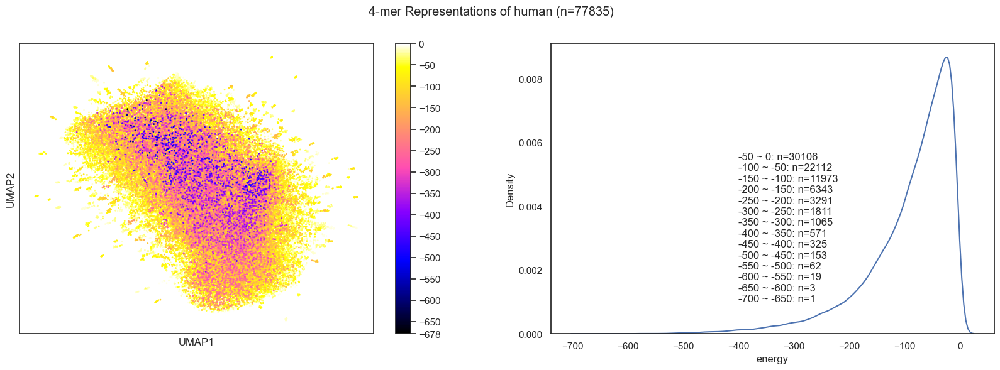

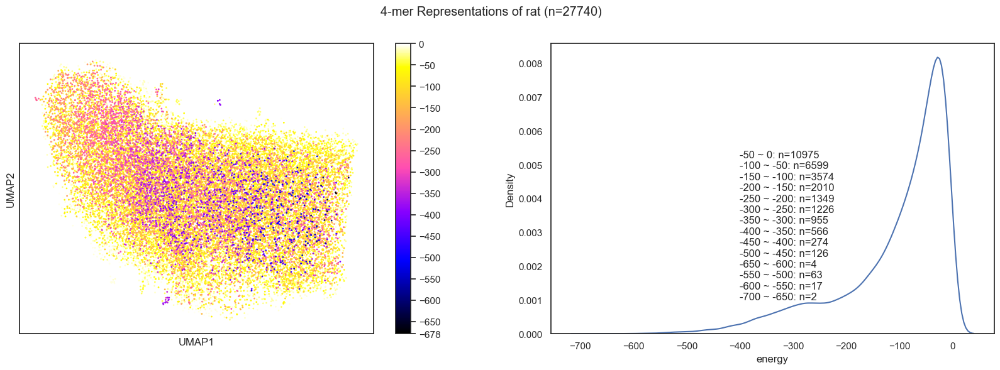

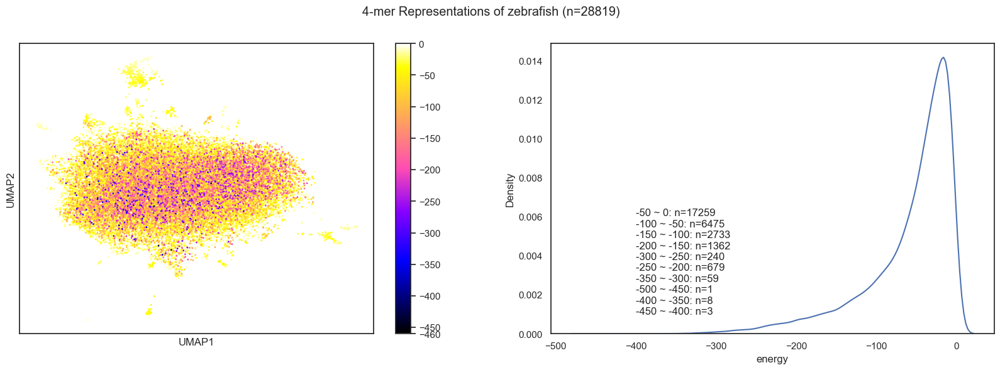

...

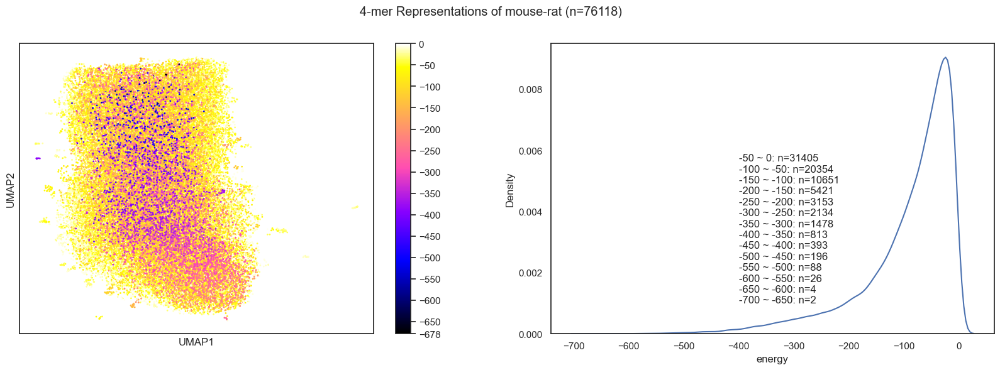

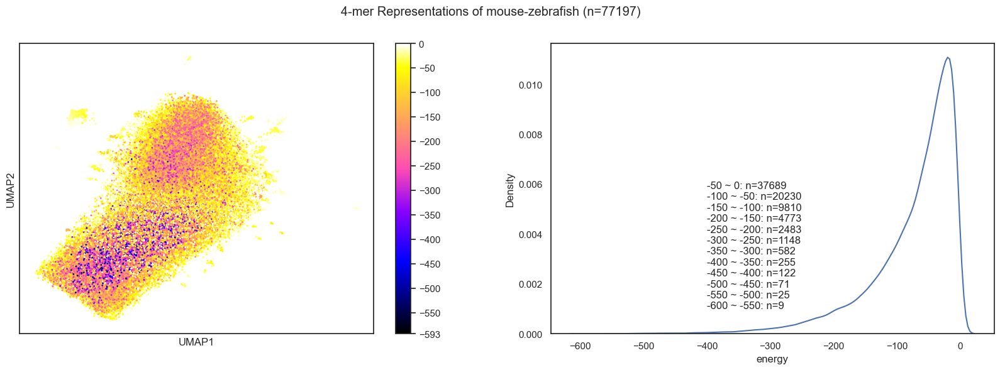

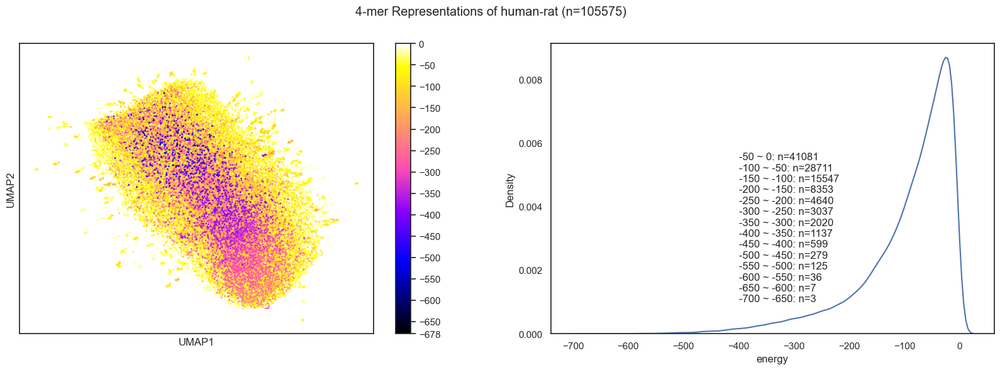

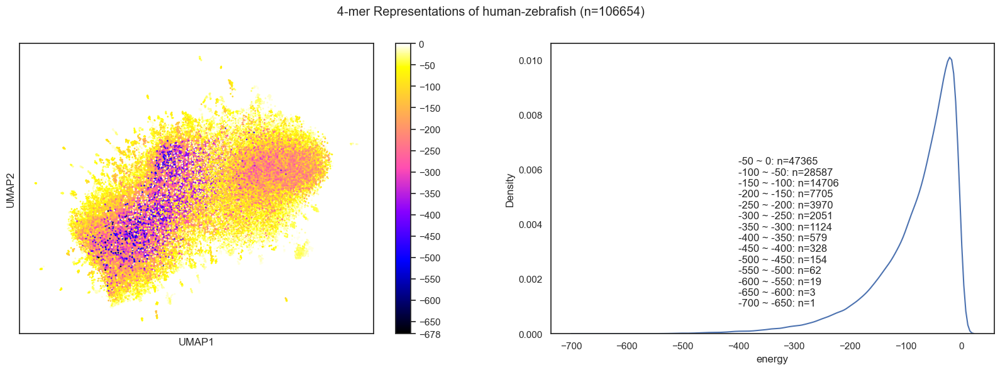

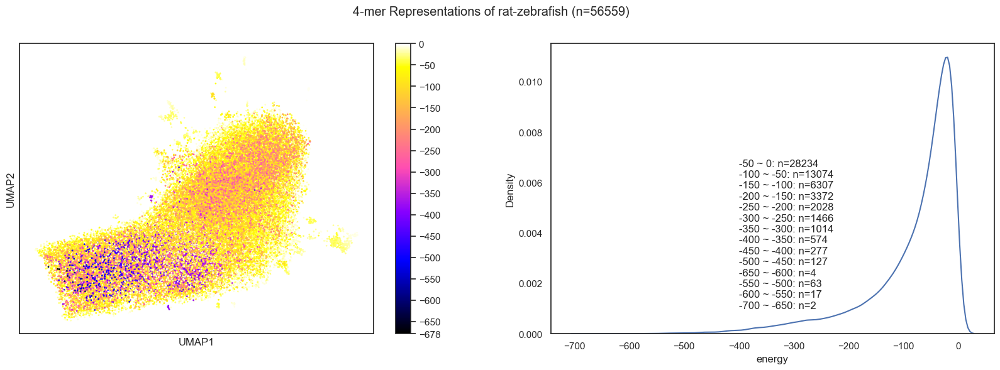

In [14]:
for species in embedding_adata_kmer_umap_dict.keys():
    temp_embedding_adata = embedding_adata_kmer_umap_dict[species]

    plot_anndata_rep_energy(
    temp_embedding_adata, color=temp_embedding_adata.obs['energy'], cmap = 'gnuplot2',
    title=f"4-mer Representations of {species} (n={len(temp_embedding_adata.obs['species'])})",
    legend_size=7, figsize = (20, 6), fname = f'4mer_{species}_Energy.svg',
    ).show()
#     break

# species

In [15]:
def plot_anndata_species(
    a,
    color,
    representation = "umap",
    representation_axes_label = "",
    swap_axes = False,
    cmap = plt.get_cmap("viridis"),
    direct_label = True,
    adjust = False,
    ax_tick = False,
    legend_size = None,
    figsize = (6.4, 4.8),
    fname = "",
    **kwargs,
):
    species_num_dict = collections.OrderedDict({'human': 77835, 'mouse': 48378, 'chicken': 31577, 'zebrafish': 28819, 'rat': 27740})

    """
    Plot the given adata's representation, directly labelling instead of using
    a legend
    """
    rep_key = "X_" + representation
#     print(rep_key)
    assert (
        rep_key in a.obsm
    ), f"Representation {representation} not fount in keys {a.obsm.keys()}"

    coords = a.obsm[rep_key]
    if swap_axes:
        coords = coords[:, ::-1]  # Reverse the columns
    assert isinstance(coords, np.ndarray) and len(coords.shape) == 2
    assert coords.shape[0] == a.n_obs
    assert color in a.obs
    color_vals = a.obs[color]
    unique_val = np.unique(color_vals.values)
    order = ['human', 'mouse', 'chicken', 'rat', 'zebrafish']
    unique_val = sorted(unique_val, key=lambda x: order.index(x))
    color_idx = [list(unique_val).index(i) for i in color_vals]
    # Vector of colors for each point
    color_vec = [cmap(i) for i in color_idx]

    fig, ax = plt.subplots(figsize=figsize)
    ax.scatter(
        coords[:, 0], coords[:, 1], s=0.5, c=color_vec, alpha=0.5
    )
    if direct_label:
        # Label each cluster
        texts = []
        for v in unique_val:
            v_idx = np.where(color_vals.values == v)
            # Median behaves better with outliers than mean
            v_coords = np.median(coords[v_idx], axis=0)
            t = ax.text(
                *v_coords,
                v,
                horizontalalignment="center",
                verticalalignment="center",
                size=legend_size,
            )
            texts.append(t)
        if adjust:
            adjust_text(
                texts,
                only_move={"texts": "y"},
                force_text=0.01,
                autoalign="y",
                avoid_points=False,
            )
    else:
        patches = []
        for i, val in enumerate(unique_val):
            p = mpatches.Patch(color=cmap(i), label=f'{val}:n={species_num_dict[val]}')
            patches.append(p)
        ax.legend(handles=patches, prop={"size": legend_size})

    rep_str = representation_axes_label if representation_axes_label else representation
    if not swap_axes:
        ax.set(
            xlabel=f"{rep_str.upper()}1", ylabel=f"{rep_str.upper()}2",
        )
    else:
        ax.set(
            xlabel=f"{rep_str.upper()}2", ylabel=f"{rep_str.upper()}1",
        )
    ax.set(**kwargs)
    if not ax_tick:
        ax.set(xticks=[], yticks=[])

#     if fname:
#         fig.savefig(fname, bbox_inches="tight", dpi = 300)
    return fig


### 自定义颜色

In [16]:
import colorsys
import random
 
def get_n_hls_colors(num):
    hls_colors = []
    i = 0
    step = 360.0 / num
    while i < 360:
        h = i
        s = 90 + random.random() * 10
        l = 50 + random.random() * 10
        _hlsc = [h / 360.0, l / 100.0, s / 100.0]
        hls_colors.append(_hlsc)
        i += step
 
    return hls_colors
 
def ncolors(num):
    rgb_colors = []
    if num < 1:
        return rgb_colors
    hls_colors = get_n_hls_colors(num)
    for hlsc in hls_colors:
        _r, _g, _b = colorsys.hls_to_rgb(hlsc[0], hlsc[1], hlsc[2])
        r, g, b = [int(x*255.0) for x in (_r, _g, _b)]
        rgb_colors.append([r/255, g/255, b/255])
 
    return rgb_colors
colors = ncolors(5)
colors

[[0.9803921568627451, 0.12156862745098039, 0.12156862745098039],
 [0.803921568627451, 0.9686274509803922, 0.1450980392156863],
 [0.19607843137254902, 0.9647058823529412, 0.5058823529411764],
 [0.1803921568627451, 0.4980392156862745, 0.9725490196078431],
 [0.807843137254902, 0.06274509803921569, 0.996078431372549]]

/tmp/ipykernel_1358479/1433229059.py:16: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('gnuplot2')


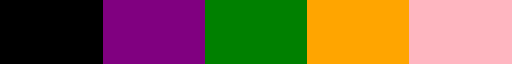

In [17]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

## 创建颜色列表
#blues_to_greens = mcolors.LinearSegmentedColormap.from_list(
#    'blues_to_greens', [(0, '#4e79a7'), (0.5, '#f1c265'), (1, '#59a14f')], N=10)
#
## 生成颜色编号列表
#colors = [blues_to_greens(i) for i in range(10)]
#

cmap = plt.cm.get_cmap('gnuplot2')
colors = ['black', 'purple', 'green', 'orange', 'lightpink']#cmap(np.linspace(0.01, 0.96, 5))
#colors = ncolors(5)
my_cmap = ListedColormap(colors)
my_cmap

### species 

In [18]:
species_num_dict = collections.OrderedDict({'human': 77835, 'mouse': 48378, 'chicken': 31577, 'zebrafish': 28819, 'rat': 27740})
species_num_dict

OrderedDict([('human', 77835),
             ('mouse', 48378),
             ('chicken', 31577),
             ('zebrafish', 28819),
             ('rat', 27740)])

100%|██████████| 16/16 [00:30<00:00,  1.89s/it]


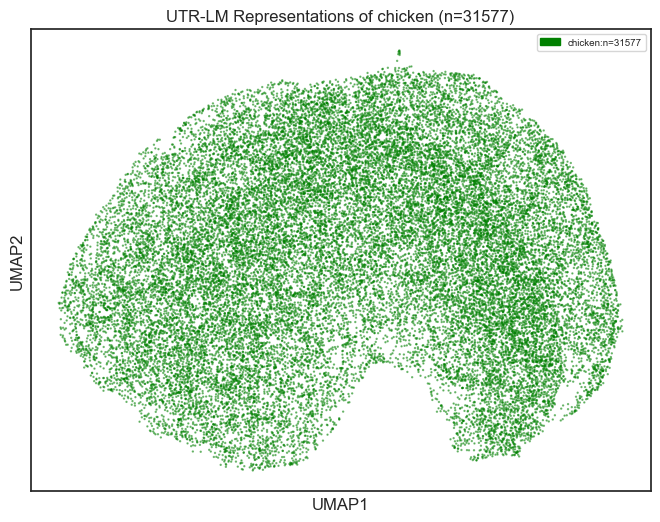

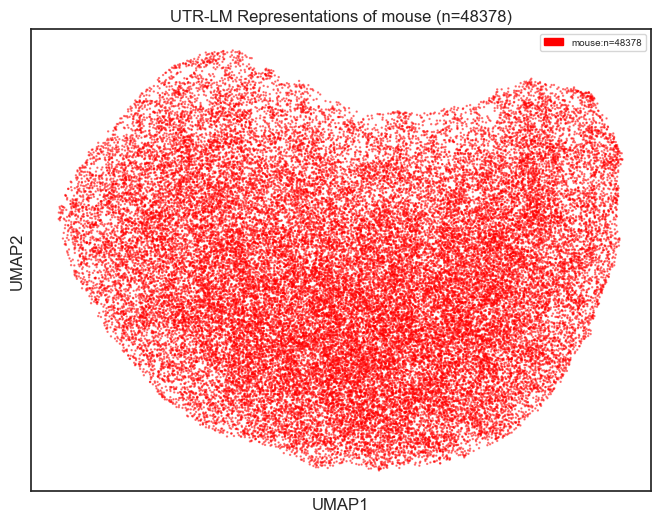

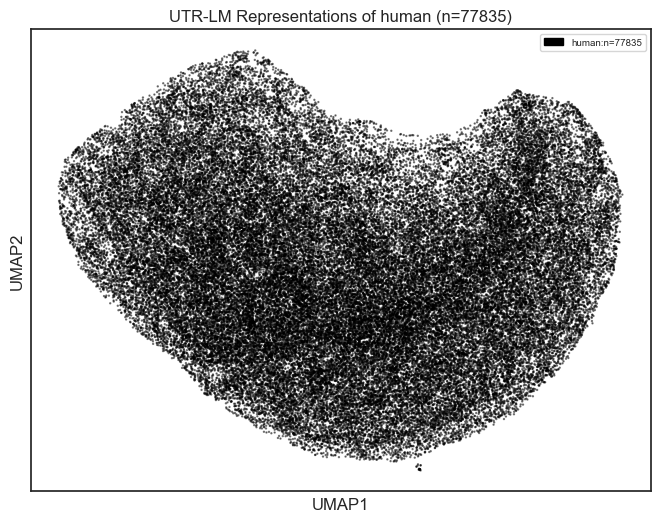

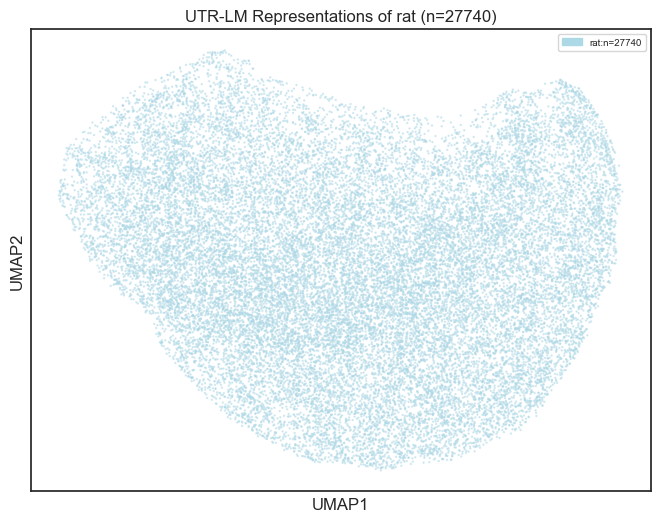

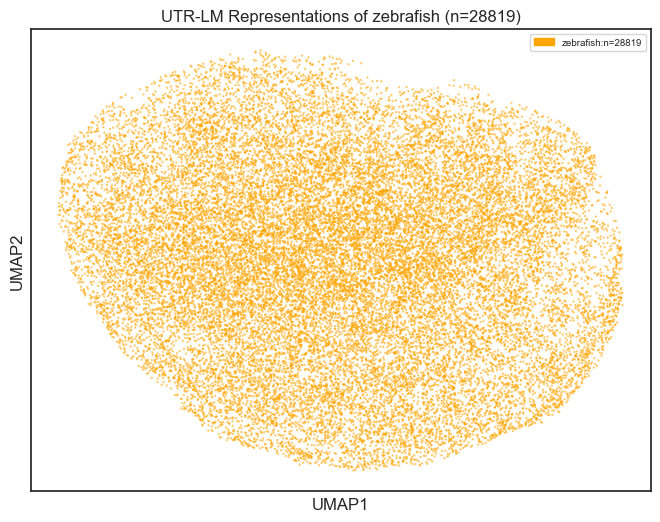

...

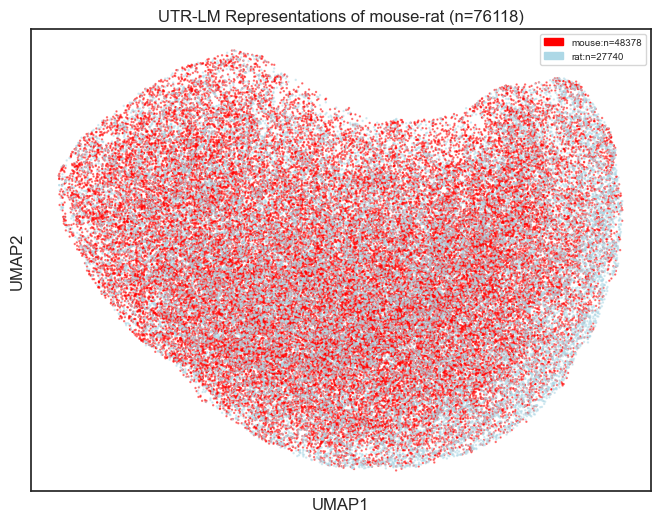

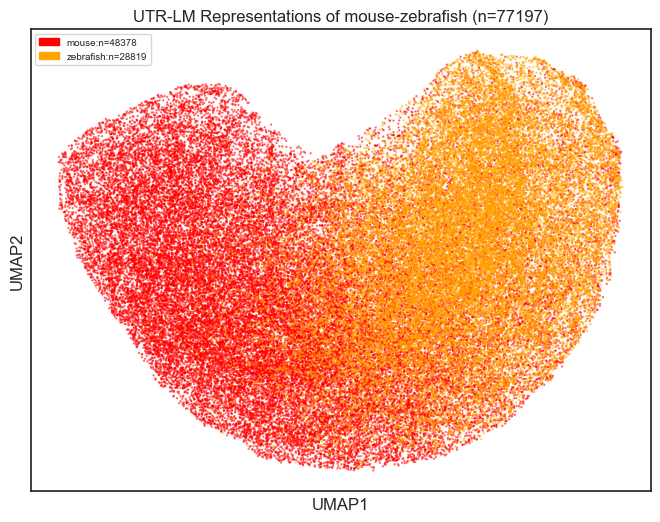

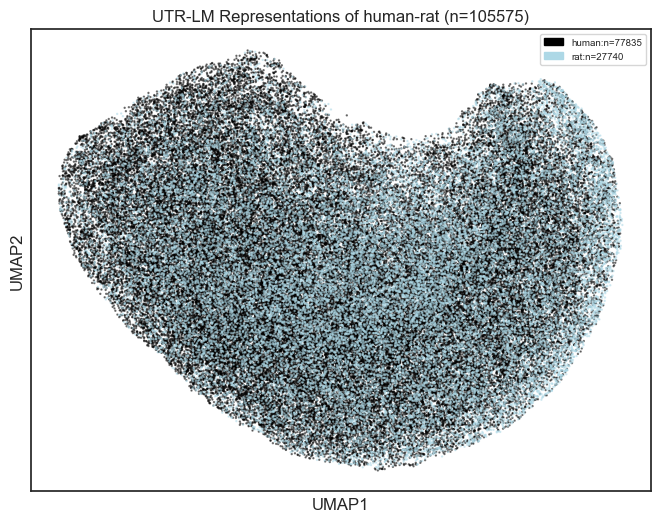

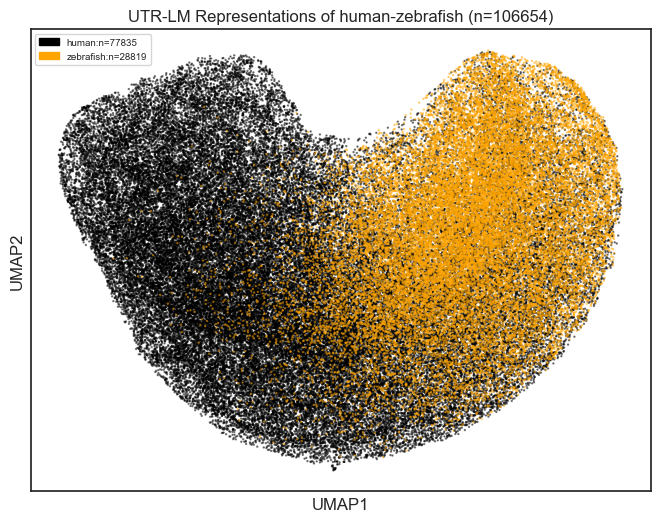

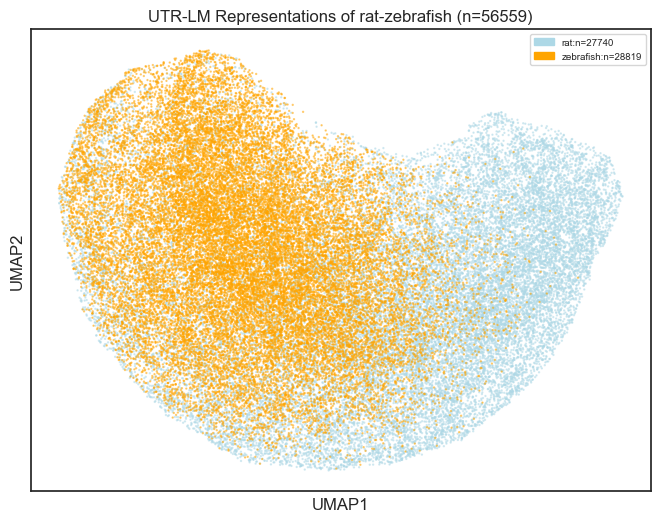

In [19]:
colors = ['black', 'red', 'green', 'orange', 'lightblue']
species_color_dict = dict(zip(['human', 'mouse', 'chicken', 'zebrafish', 'rat'], colors))
for species in tqdm(embedding_adata_esm2_umap_dict.keys()):
    if species == 'all':
        color_map = colors
    elif '-' in species:
        pair_species = species.split('-')
        color_map = [species_color_dict[c] for c in pair_species]
    else:
        color_map = species_color_dict[species]
    my_cmap = ListedColormap(color_map)
    
    temp_embedding_adata = embedding_adata_esm2_umap_dict[species]
    
    plot_anndata_species(
    temp_embedding_adata, color='species', direct_label=False, cmap=my_cmap,
    title=f"UTR-LM Representations of {species} (n={len(temp_embedding_adata.obs['species'])})",
    legend_size=7, figsize = (8, 6), fname = f'UTRLM_{species}_SpeciesClass.tif',
    ).show()
#     break

100%|██████████| 16/16 [00:28<00:00,  1.81s/it]


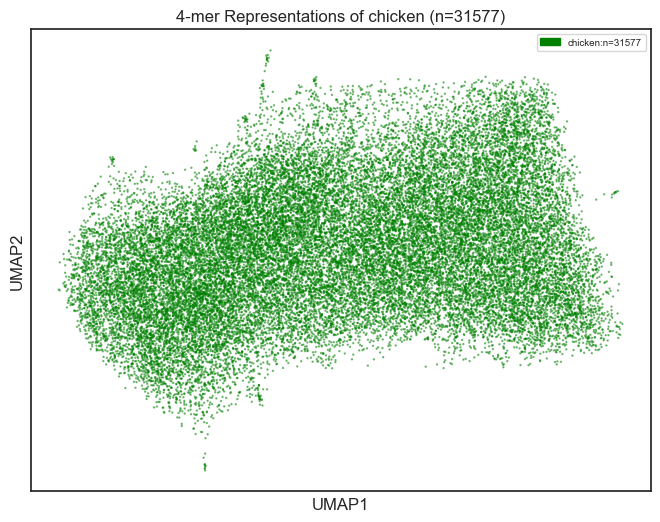

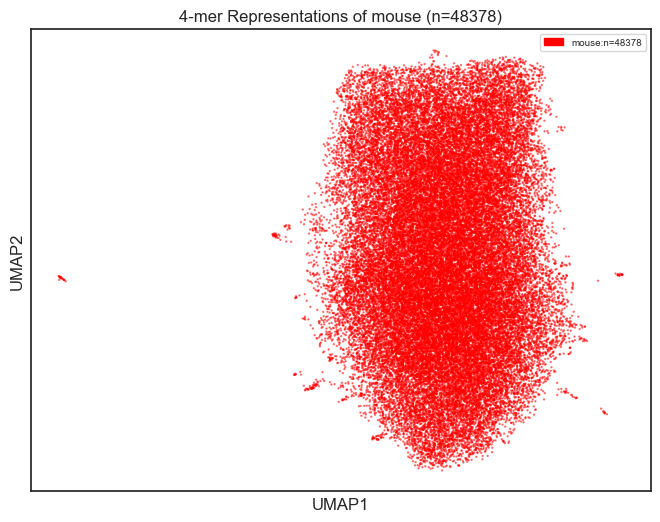

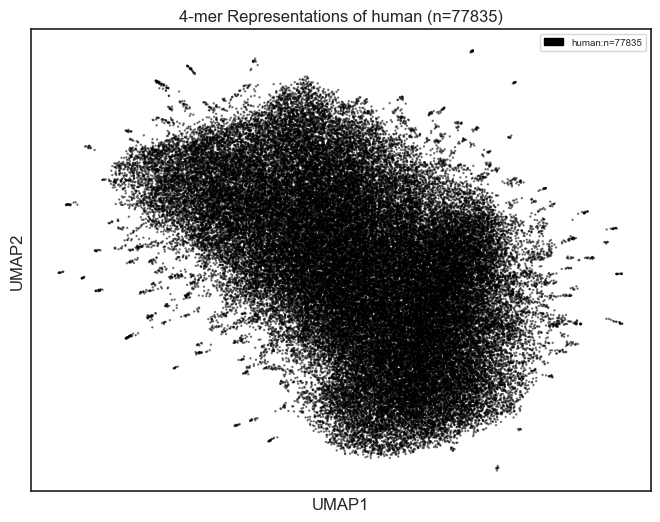

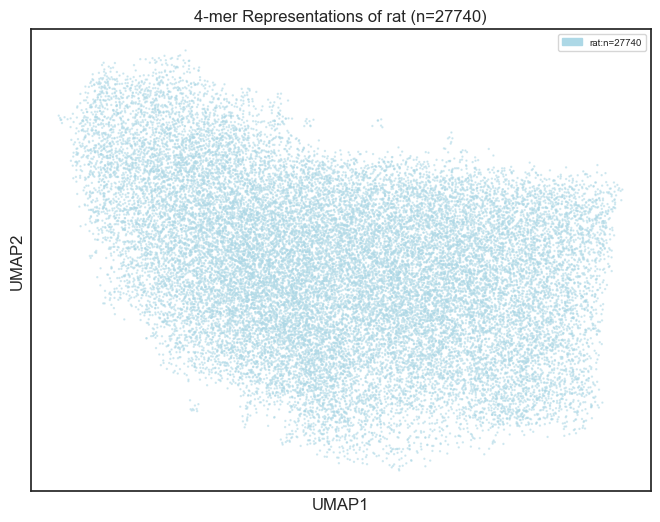

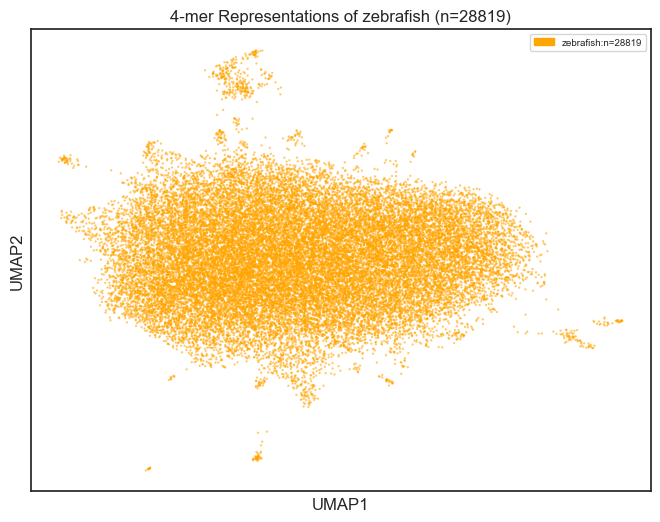

...

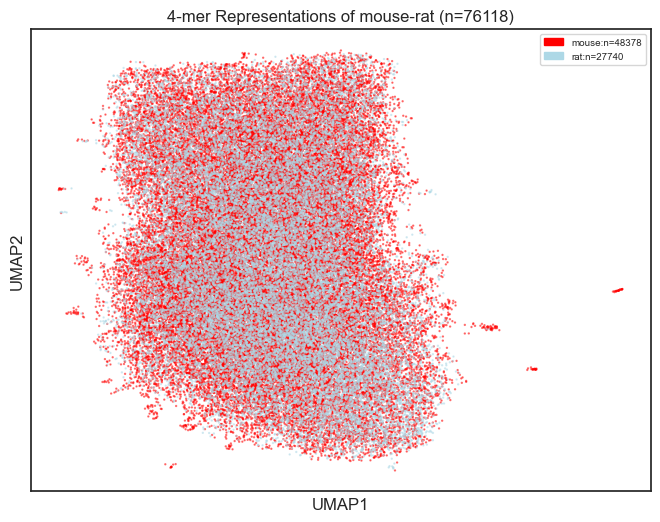

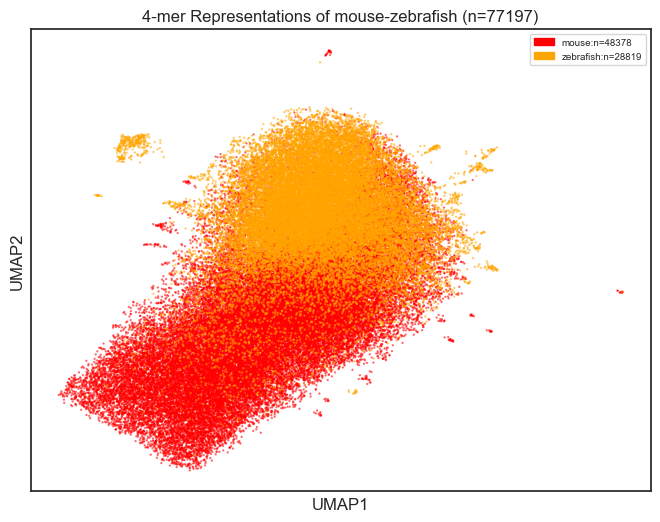

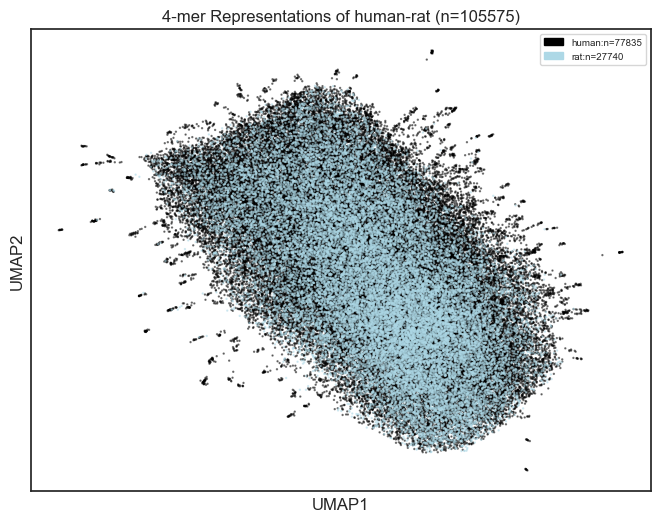

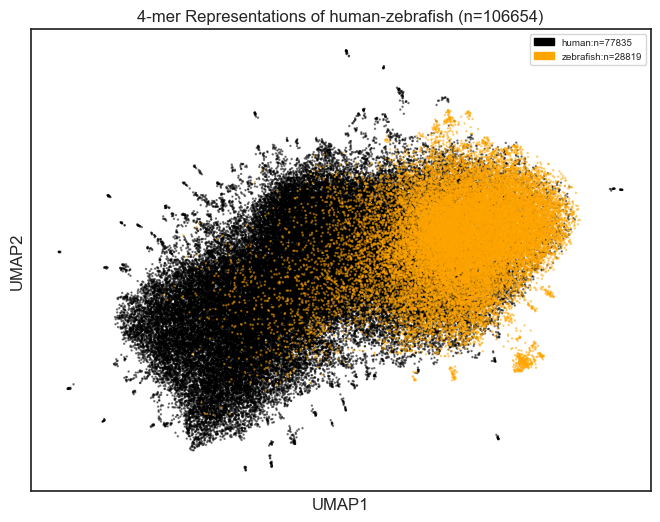

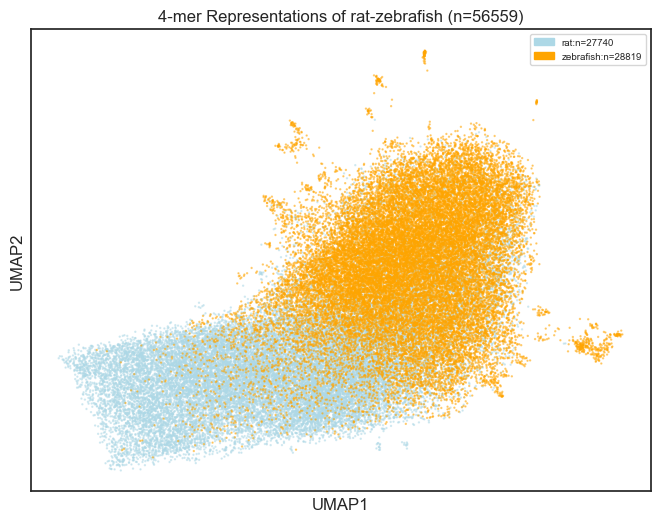

In [20]:
colors = ['black', 'red', 'green', 'orange', 'lightblue']
species_color_dict = dict(zip(['human', 'mouse', 'chicken', 'zebrafish', 'rat'], colors))
for species in tqdm(embedding_adata_kmer_umap_dict.keys()):
    if species == 'all':
        color_map = colors
    elif '-' in species:
        pair_species = species.split('-')
        color_map = [species_color_dict[c] for c in pair_species]
    else:
        color_map = species_color_dict[species]
    my_cmap = ListedColormap(color_map)
    
    temp_embedding_adata = embedding_adata_kmer_umap_dict[species]
    
    plot_anndata_species(
    temp_embedding_adata, color='species', direct_label=False, cmap=my_cmap,
    title=f"4-mer Representations of {species} (n={len(temp_embedding_adata.obs['species'])})",
    legend_size=7, figsize = (8, 6), fname = f'4-mer_{species}_SpeciesClass.tif',
    ).show()

# logo

In [21]:
def read_fasta(fname: str):
    """Read fa file, returning a dict of seq names to seqs"""
    retval = {}
    curr_key, curr_seq = "", ""
    with open(fname) as source:
        for line in source:
            line = line.strip()
            if line.startswith(">"):
                if curr_key:  # Previous record
                    assert curr_seq
                    retval[curr_key] = curr_seq
                curr_key = line.strip(">").strip()
                curr_seq = ""  # Reset
            else:
                curr_seq += line.strip()
    if curr_key:  # Store trailing record
        assert curr_seq
        retval[curr_key] = curr_seq
    return retval


In [22]:
def per_position_aa_count(
    sequences, *, normalize = False, psuedocount = 0,
):
    """
    Return a count matrix of (seq_len, n_amino_acids) reflecting
    counts of each amino acid at each base
    """
    max_len = max([len(x) for x in sequences])
    seq_mat = np.stack([np.array((max_len - len(x)) * ['N'] + list(x)) for x in sequences])
#     print(seq_mat)
    num_seq, fixed_len = seq_mat.shape
    assert num_seq == len(sequences)
    per_pos_counts = []
    for j in range(fixed_len):
        col = seq_mat[:, j]
        assert len(col) == num_seq
        counter = collections.Counter(col)
        count_vec = np.array([counter[aa] for aa in 'AGCT'])
        count_vec += psuedocount
        per_pos_counts.append(count_vec)
    per_pos_counts = np.stack(per_pos_counts)
    assert per_pos_counts.shape == (seq_mat.shape[1], len('AGCT'))
    # assert np.allclose(np.sum(per_pos_counts, 1), np.sum(per_pos_counts[0]))
    if normalize:
        row_sums = set(per_pos_counts.sum(axis=1).tolist())
        assert len(row_sums) == 1
        per_pos_counts = per_pos_counts.astype(np.float64)
        per_pos_counts /= row_sums.pop()
        assert np.all(np.isclose(per_pos_counts.sum(axis=1), 1.0))
    retval = pd.DataFrame(per_pos_counts, columns=list('AGCT'))
    return retval


In [23]:
def logo_files(embedding_adata, prefix = ''):
    clusters = [str(i) for i in range(len(collections.Counter(embedding_adata.obs['leiden'])))]
    input_fname, output_fname = [], []
    for cluster in clusters:
        cluster_of_interest = embedding_adata.obs.iloc[
                np.where(embedding_adata.obs['leiden'] == cluster)
            ]
        tempdir = '/home/ubuntu/esm2/Pretrained/Embedding_Contacts/ESM2_pretrained/representations_bos/'

        # Write the MUSCLE input
        logging.debug(f"Running MUSCLE for MSA in {tempdir}")
        muscle_input_fname = os.path.join(tempdir, f"{prefix}_msa_input_{cluster}.fa")
        with open(muscle_input_fname, "w") as sink:
            sink.write("\n".join([f"> {i}\n{seq}" for i, seq in enumerate(cluster_of_interest['seqeuences'])]))
            sink.write("\n")
        # Call MUSCLE
        #print(tempdir)
        #print(muscle_input_fname)

        muscle_output_fname = os.path.join(tempdir, f"{prefix}_msa_output_{cluster}.fa")
        #print(muscle_output_fname)
        muscle_cmd = f"nohup muscle -in {muscle_input_fname} -out {muscle_output_fname} 2>&1 &"
        print(muscle_cmd)
        input_fname.append(muscle_input_fname)
        output_fname.append(muscle_output_fname)
    return input_fname, output_fname

In [24]:
def logo_graph(files, save_fig = False, title = '', aa_num = ''):
    for f in files:
        logo_kwargs = {
            "show_spines": False,
            "alpha": 0.9,
        }
        msa_seqs = list(read_fasta(f).values()) # if msa: outputfile; elif no msa:inputfile
#         print(msa_seqs)
        msa_pwm = per_position_aa_count(msa_seqs, normalize=False)
        if aa_num: msa_pwm = msa_pwm[-aa_num:]
        fig, ax = plt.subplots(figsize=(10, 0.5), dpi = 300)
        logo = logomaker.Logo(msa_pwm, ax=ax, **logo_kwargs) # 
        if title:
            ax.set(title = f'{title}')
        else:
            ax.set(title = f'Leiden Cluster {f.split("_")[-1][:-3]}')
        if save_fig: fig.savefig(f.replace('.fasta', f'_{aa_num}.pdf').replace('.fa', f'_{aa_num}.pdf'), bbox_inches="tight")

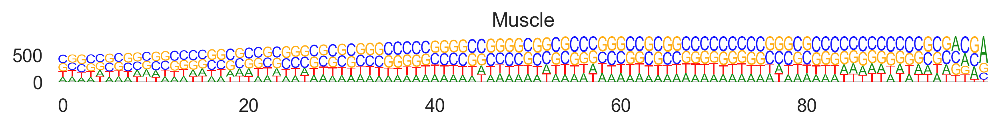

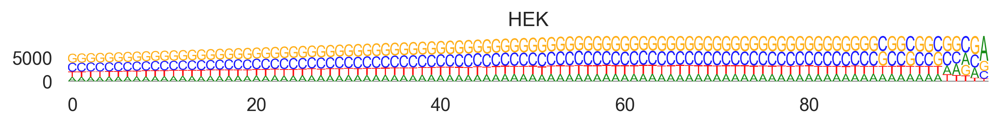

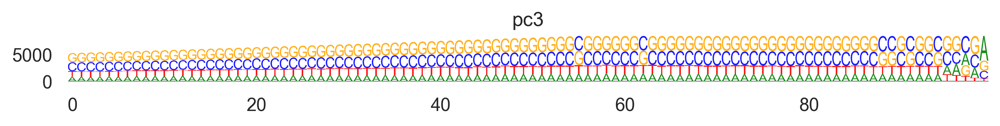

In [25]:
for t in ['Muscle', 'HEK', 'pc3']:
    logo_graph([f'/home/ubuntu/5UTR_Optimizer-master/data/{t}_sequence.fa'], 
               save_fig = True, title = t)

/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_mouse_energy_structure_48378sequence.fasta
/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_human_energy_structure_77835sequence.fasta
/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_chicken_energy_structure_31577sequence.fasta
/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_rat_energy_structure_27740sequence.fasta
/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_zebrafish_energy_structure_28819sequence.fasta


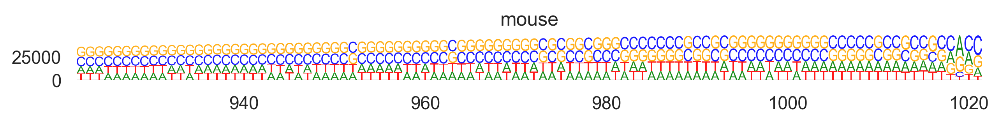

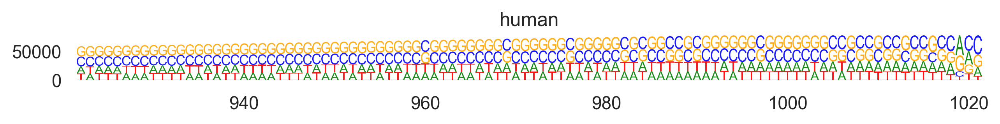

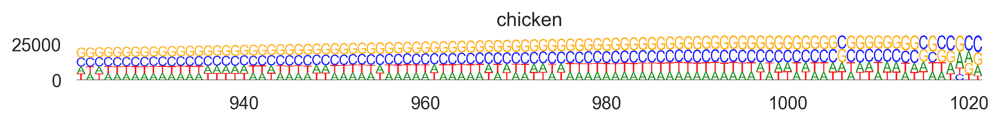

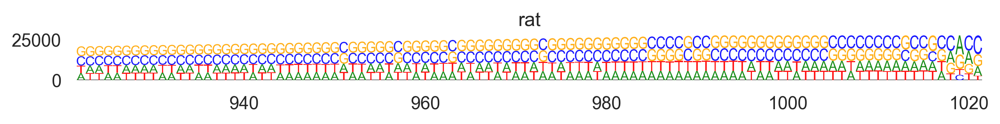

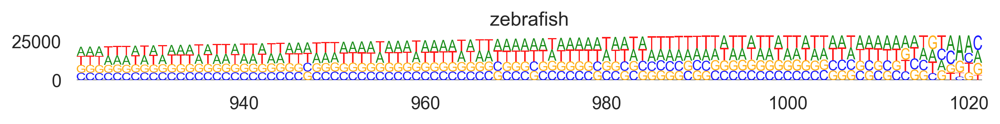

In [26]:
species_fasta = ['/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_mouse_energy_structure_48378sequence.fasta'
,'/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_human_energy_structure_77835sequence.fasta'
,'/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_chicken_energy_structure_31577sequence.fasta'
,'/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_rat_energy_structure_27740sequence.fasta'
,'/home/ubuntu/human_5utr_modeling-master/data/Fivespecies_zebrafish_energy_structure_28819sequence.fasta']

for sf in species_fasta:
    print(sf)
    logo_graph([sf.replace(' ','')], True, sf.split('/')[-1].split('_')[1], 100)


# Leiden

In [27]:
for species in tqdm(embedding_adata_esm2_umap_dict.keys()):
    if species == 'all' or '-' in species:
        
        sc.tl.leiden(embedding_adata_esm2_umap_dict[species], resolution=2.0)
        plot_anndata_rep(
            embedding_adata_esm2_umap_dict[species], color='leiden', direct_label=True,
            title=f"ESM2 for Leiden clustering: {species} Last Layer Representation\nPCA->KNN->UMAP->Leiden Clustering",
            legend_size=8,
            fname = f'ESM2_{species}_Leiden.pdf'
        ).show()


 31%|███▏      | 5/16 [04:03<08:55, 48.73s/it]


NameError: name 'plot_anndata_rep' is not defined

In [ ]:
for species in tqdm(embedding_adata_kmer_umap_dict.keys()):
    if species == 'all' or '-' in species:
        
        sc.tl.leiden(embedding_adata_kmer_umap_dict[species], resolution=2.0)
        plot_anndata_rep(
            embedding_adata_kmer_umap_dict[species], color='leiden', direct_label=True,
            title=f"4-mer for Leiden clustering: {species} Last Layer Representation\nPCA->KNN->UMAP->Leiden Clustering",
            legend_size=8,
            fname = f'ESM2_{species}_Leiden.pdf'
        ).show()


In [ ]:
esm2_all_input_fname, esm2_all_output_fname = logo_files(embedding_adata_esm2_umap_dict['all'], 'FiveSpecies_All_ESM2')
kmer_all_input_fname, kmer_all_output_fname = logo_files(embedding_adata_kmer_umap_dict['all'], 'FiveSpecies_All_4mer')

In [ ]:
logo_graph(esm2_all_input_fname, save_fig = True)

In [ ]:
logo_graph(esm2_all_input_fname, save_fig = True)

In [ ]:
logo_graph(kmer_all_input_fname, save_fig = True)

In [ ]:
logo_graph(all_output_fname)

# silhouette

In [ ]:
silh_score_df = []
for species in embedding_adata_esm2_umap_dict.keys():
    if species == 'all' or '-' in species:
        silh_score = metrics.silhouette_score(embedding_adata_esm2_umap_dict[species].X,
                                              embedding_adata_esm2_umap_dict[species].obs['species'])
        print(f'ESM2 for species clustering: {species} silhouette_score = {silh_score}')
        silh_score_df.append(['ESM2', 'species', species, silh_score])

In [ ]:
for species in embedding_adata_kmer_umap_dict.keys():
    if species == 'all' or '-' in species:
        silh_score = metrics.silhouette_score(embedding_adata_kmer_umap_dict[species].X,
                                              embedding_adata_kmer_umap_dict[species].obs['species'])
        print(f'4-mer for species clustering: {species} silhouette_score = {silh_score}')
        silh_score_df.append(['4-mer', 'species', species, silh_score])

In [ ]:
for species in embedding_adata_esm2_umap_dict.keys():
    if species == 'all' or '-' in species:
        silh_score = metrics.silhouette_score(embedding_adata_esm2_umap_dict[species].X,
                                              embedding_adata_esm2_umap_dict[species].obs['energy_class'])
        print(f'ESM2 for energy clustering: {species} silhouette_score = {silh_score}')
        silh_score_df.append(['ESM2', 'Energy', species, silh_score])

In [ ]:
for species in embedding_adata_kmer_umap_dict.keys():
    if species == 'all' or '-' in species:
        silh_score = metrics.silhouette_score(embedding_adata_kmer_umap_dict[species].X,
                                              embedding_adata_kmer_umap_dict[species].obs['energy_class'])
        print(f'4-mer for energy clustering: {species} silhouette_score = {silh_score}')
        silh_score_df.append(['4-mer', 'Energy', species, silh_score])

In [ ]:
for species in tqdm(embedding_adata_kmer_umap_dict.keys()):
    if species == 'all' or '-' in species:
        
        silh_score = metrics.silhouette_score(embedding_adata_kmer_umap_dict[species].X,
                                              embedding_adata_kmer_umap_dict[species].obs['leiden'])
        print(f'4-mer for Leiden clustering: {species} silhouette_score = {silh_score}')
        silh_score_df.append(['4-mer', 'Leiden', species, silh_score])


In [ ]:
for species in tqdm(embedding_adata_esm2_umap_dict.keys()):
    if species == 'all' or '-' in species:
        
        silh_score = metrics.silhouette_score(embedding_adata_esm2_umap_dict[species].X,
                                              embedding_adata_esm2_umap_dict[species].obs['leiden'])
        print(f'ESM2 for Leiden clustering: {species} silhouette_score = {silh_score}')
        silh_score_df.append(['ESM2', 'Leiden', species, silh_score])


In [ ]:
silh_score_df = pd.DataFrame(silh_score_df, columns = ['Representation', 'Cluster Type', 'Species', 'silhouette_score'])
silh_score_df

In [ ]:
#silh_score_df.to_csv('silhouette_score.csv')